In [ ]:
# Fits CellCharter to data with given number of niches

In [72]:
import scanpy as sc
import pandas as pd

import matplotlib.pyplot as plt

import seaborn as sns

import celltypist
from celltypist import models

from matplotlib import rcParams

import squidpy as sq
import cellcharter as cc

In [2]:
# Load global object
adata = sc.read_h5ad("h5ad/xenium5k_scVI.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [4]:
# Formating
adata.obs.sample = adata.obs['sample']

In [5]:
# Load mesenchymal object with reannotations
adata_mesen = sc.read_h5ad("h5ad/scvi/xenium5k_scVI_annotated_mesenchymal.h5ad")

In [6]:
adata_mesen

AnnData object with n_obs × n_vars = 181597 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [7]:
# Combine annotations
adata.obs['annot'] = adata.obs.megagut_lvl3_majority_voting.astype('str')

In [8]:
adata_mesen.obs.annot2.value_counts()

annot2
SMC_PPLP2               40301
SMC_CAPN3               22528
S3_crypt                14636
S3_oral_mucosa-like     12090
S3_lamina propria        7801
Myofibroblast_1          7654
S4                       7532
Pericyte_1               7467
Pericyte_2               6786
vSMC                     6402
S3x_1                    5907
S5                       4942
S3x_2                    4890
Myofibroblast-SMC        4545
S1_2                     4377
Villus fibroblast_F3     3632
S3_EGR3                  2583
Myofibroblast_2          2581
S1_1                     1908
S2                       1739
SMC_ANO1                 1435
S3_intermediate           772
S3_GATA2                  548
Myofibroblast_3           493
Name: count, dtype: int64

In [9]:
# Transfer mesenchymal annotations to 'annot'

In [10]:
adata.obs = adata.obs.join(adata_mesen.obs.annot2)

In [11]:
idx = ~adata.obs.annot2.isna()
adata.obs.annot[idx] = adata.obs.annot2[idx]

/tmp/ipykernel_216/875854880.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.annot[idx] = adata.obs.annot2[idx]


In [12]:
pd.set_option('display.max_rows', 200)


In [76]:
# remove remaining annotations that are reannotated
adata.obs.annot.value_counts()

annot
Enterocyte                    117653
B_plasma_IgA1                  54688
B_memory                       54126
SMC_PPLP2                      45725
Trm/em_CD8                     37432
EC_venous                      30492
SMC_CAPN3                      23440
Treg_IL10                      20185
Tnaive/cm_CD4                  19697
Macrophage                     17878
Trm_CD8                        16973
S3_crypt                       14636
Macrophage_LYVE1               12504
Glial/Enteric_neural_crest     12230
S3_oral_mucosa-like            12090
Goblet                         10811
S3_lamina propria               7801
Myofibroblast_1                 7654
S4                              7532
Pericyte_1                      7467
Monocyte                        7217
Pericyte_2                      6786
vSMC                            6402
S3x_1                           5907
EC_arterial_2                   5857
TA                              5638
Mast                            

In [83]:
#adata.obs.annot = adata.obs.annot.astype("str")

In [86]:
exclude = [
    # Cell types that are reannotated but not covered. Leftover cells from CellTypist predictions that haven't been updated with new, higher confidence labels.
    'Oral_mucosa_fibroblast', 'Vascular_smooth_muscle', 'Fibroblast_reticular', 'Crypt_fibroblast_PI16', 'Pericyte', 'Myofibroblast', 'Lamina_propria_fibroblast_ADAMDEC1', 'Villus_fibroblast_F3',
    "S3_GATA2"  # small population that is actually a mast cell

]

adata.obs.annot[adata.obs.annot.isin(exclude)] = pd.NA

/tmp/ipykernel_216/3740932853.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.annot[adata.obs.annot.isin(exclude)] = pd.NA


In [95]:
adata.obs.annot.value_counts()

annot
Enterocyte                    117653
B_plasma_IgA1                  54688
B_memory                       54126
SMC_PPLP2                      45725
Trm/em_CD8                     37432
EC_venous                      30492
SMC_CAPN3                      23440
Treg_IL10                      20185
Tnaive/cm_CD4                  19697
Macrophage                     17878
Trm_CD8                        16973
S3_crypt                       14636
Macrophage_LYVE1               12504
Glial/Enteric_neural_crest     12230
S3_oral_mucosa-like            12090
Goblet                         10811
nan                             8890
S3_lamina propria               7801
Myofibroblast_1                 7654
S4                              7532
Pericyte_1                      7467
Monocyte                        7217
Pericyte_2                      6786
vSMC                            6402
S3x_1                           5907
EC_arterial_2                   5857
TA                              

In [1]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,       
    color=['sample', 'leiden', 'megagut_lvl1_majority_voting', 'megagut_lvl3_majority_voting', 'annot'],
#    palette=sc.pl.palettes.default_102,
    wspace=2.0,
)

NameError: name 'rcParams' is not defined

In [103]:
sc.set_figure_params(dpi_save=300)

In [105]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

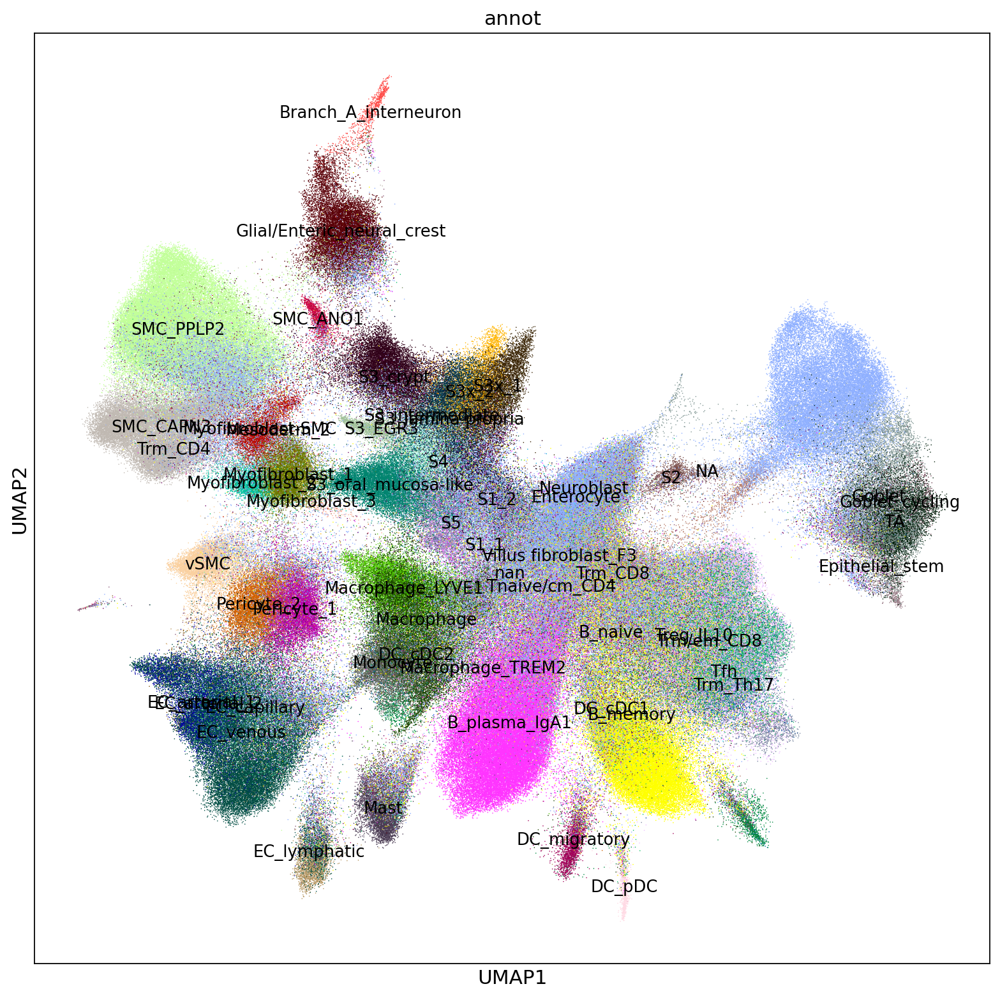

In [89]:
rcParams["figure.figsize"] = (12, 12)

sc.pl.umap(
    adata,       
    color=['annot'],
    palette=sc.pl.palettes.default_102,
#    wspace=3.0,
    legend_loc='on data', legend_fontweight='normal', legend_fontsize='small',
    size=2
)

In [17]:
from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

# Investigate markers of CellTypist labels
sc.tl.rank_genes_groups(adata, groupby='annot', method='wilcoxon')

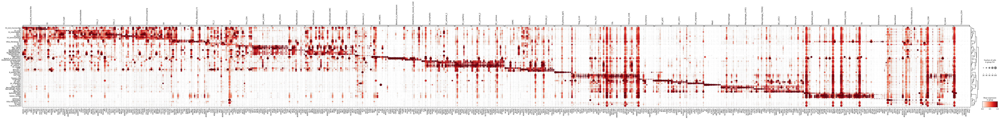

In [18]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby='annot', standard_scale="var", n_genes=10, title="", figsize=(48 *2, 8)
)

# Spatial clustering

In [19]:
# Spatial neighborhood graph
sq.gr.spatial_neighbors(adata, library_key='sample', coord_type='generic', delaunay=True)

In [20]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [25]:
adata.obs.sample = adata.obs['sample']
adata.obs.sample

0033516_adjacent_aaaalbkb-1    0033516_adjacent
0033516_adjacent_aaaambfn-1    0033516_adjacent
0033516_adjacent_aaabjcij-1    0033516_adjacent
0033516_adjacent_aaacbbae-1    0033516_adjacent
0033516_adjacent_aaacnfcj-1    0033516_adjacent
                                     ...       
0043587_affected_oinhbmma-1    0043587_affected
0043587_affected_oinhjjbb-1    0043587_affected
0043587_affected_oinhkjfn-1    0043587_affected
0043587_affected_oinihmac-1    0043587_affected
0043587_affected_oinjbpdh-1    0043587_affected
Name: sample, Length: 646121, dtype: category
Categories (4, object): ['0033516_adjacent', '0033516_affected', '0043587_adjacent', '0043587_affected']

In [26]:
# Initiliaze spatial data structure. Needed for squidpy visualization, although data here is empty.
adata.uns['spatial'] = {library_id: {} for library_id in adata.obs.sample.cat.categories}

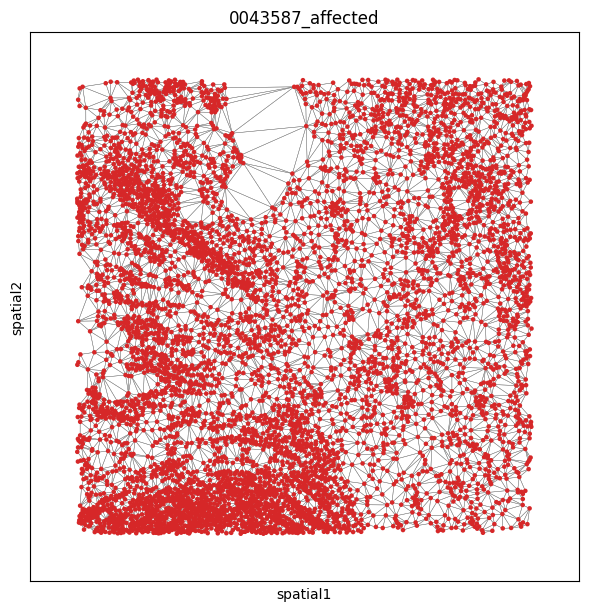

In [27]:
#library_id = "0043587_adjacent"
library_id = "0043587_affected"

rcParams["figure.figsize"] = (6, 6)

sq.pl.spatial_scatter(
    adata, 
    color='sample', 
    library_key='sample', 
    img=None, 
#    title=['BALBc-3'],
    title=library_id,
    size=5,
    connectivity_key='spatial_connectivities',
    edges_width=0.3,
    legend_loc=None,
    crop_coord=(500, 500, 1500, 1500 ),
    #library_id=['0043587_affected']
    library_id=[library_id]

)

In [28]:
cc.gr.remove_long_links(adata)


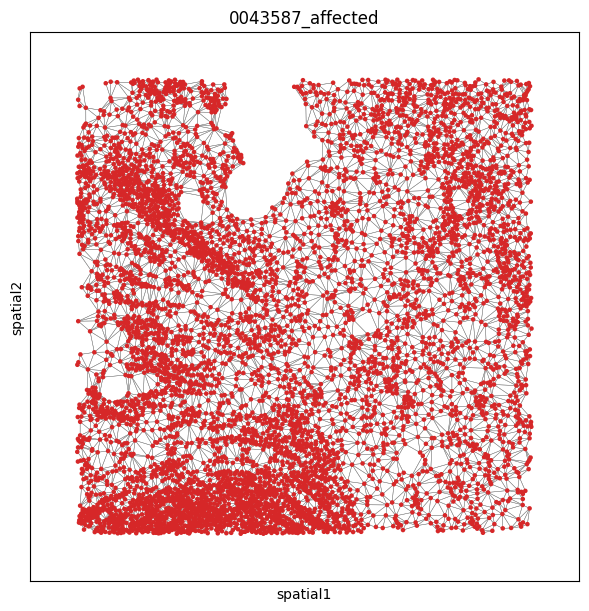

In [29]:
#library_id = "0043587_adjacent"
library_id = "0043587_affected"

rcParams["figure.figsize"] = (6, 6)

sq.pl.spatial_scatter(
    adata, 
    color='sample', 
    library_key='sample', 
    img=None, 
#    title=['BALBc-3'],
    title=library_id,
    size=5,
    connectivity_key='spatial_connectivities',
    edges_width=0.3,
    legend_loc=None,
    crop_coord=(500, 500, 1500, 1500 ),
    #library_id=['0043587_affected']
    library_id=[library_id]

)

In [30]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [31]:
# Neighborhood aggregation
cc.gr.aggregate_neighbors(adata, n_layers=3, use_rep='X_scVI')


  0%|          | 0/4 [00:00<?, ?it/s]

In [32]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [33]:
# # Determine number of clusters
# model_params = {
#         'random_state': 42,
#         'trainer_params': {
#             'accelerator':'cpu',
#             'enable_progress_bar': False
#         },
# }

# models = cc.tl.ClusterAutoK(n_clusters=(4,16), model_class=cc.tl.GaussianMixture, model_params=model_params, max_runs=5)

In [34]:
# models.fit(adata, use_rep='X_cellcharter')

In [35]:
# rcParams["figure.figsize"] = (4.5, 3)

# ax = cc.pl.autok_stability(models, return_ax=True)
# ax.grid(False)
# ax.figure.savefig("figures_niches/CellCharter_stability.pdf", bbox_inches='tight')

## 15 clusters

In [36]:
gmm = cc.tl.Cluster(
    n_clusters=15, 
    random_state=42,
    # If running on GPU
    #trainer_params=dict(accelerator='gpu', devices=1)
)

In [37]:
gmm.fit(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=29` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=300` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=1` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training: |          | 0/? [00:00<?, ?it/s]

In [38]:
adata.obs['spatial_cluster15'] = gmm.predict(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Predicting: |          | 0/? [00:00<?, ?it/s]

In [3]:
rcParams["figure.figsize"] = (6, 6)
sc.set_figure_params(dpi_save=300)

sq.pl.spatial_scatter(
    adata, 
    color='spatial_cluster15', 
    library_key='sample', 
    img=None, 
    title=adata.obs.sample.cat.categories,
    size=8,
    ncols=4,
    library_id=adata.obs.sample.cat.categories,
    save="figures_niches/CellCharter_niches15.pdf", dpi=300
)

NameError: name 'rcParams' is not defined

In [40]:
cc.gr.enrichment(adata, group_key='spatial_cluster15', label_key='annot')

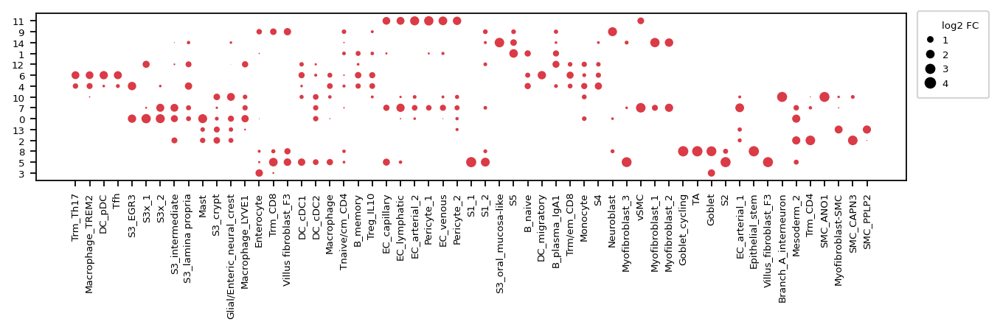

In [90]:
cc.pl.enrichment(
    adata,
    group_key='spatial_cluster15', label_key='annot',
    figsize=(8,3), fontsize=6, dot_scale=1,
    label_cluster=True,
    save="figures_niches/CellCharter_niches15_enrichment_dotplot.pdf")

In [42]:
# rcParams["figure.figsize"] = (6, 6)

# sq.pl.spatial_scatter(
#     adata, 
#     color='spatial_cluster', 
#     library_key='sample', 
#     img=None, 
#     title=adata.obs.sample.cat.categories,
#     size=8,
#     ncols=4,
#     library_id=adata.obs.sample.cat.categories,
#     save="figures_niches/CellCharter_niches11.pdf", dpi=300 
# )

## 17 clusters

In [49]:
gmm = cc.tl.Cluster(
    n_clusters=17, 
    random_state=42,
    # If running on GPU
    #trainer_params=dict(accelerator='gpu', devices=1)
)

In [50]:
gmm.fit(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=33` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=300` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=1` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training: |          | 0/? [00:00<?, ?it/s]

In [51]:
adata.obs['spatial_cluster17'] = gmm.predict(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Predicting: |          | 0/? [00:00<?, ?it/s]

In [2]:
rcParams["figure.figsize"] = (6, 6)
sc.set_figure_params(dpi_save=450)

sq.pl.spatial_scatter(
    adata, 
    color='spatial_cluster17', 
    library_key='sample', 
    img=None, 
    title=adata.obs.sample.cat.categories,
    size=8,  # point size
    ncols=4,
    wspace=0.5,  # inter-panel width
    library_id=adata.obs.sample.cat.categories,
    save="figures_niches/CellCharter_niches17.pdf", dpi=450
)

NameError: name 'rcParams' is not defined

In [58]:
cc.gr.enrichment(adata, group_key='spatial_cluster17', label_key='annot')

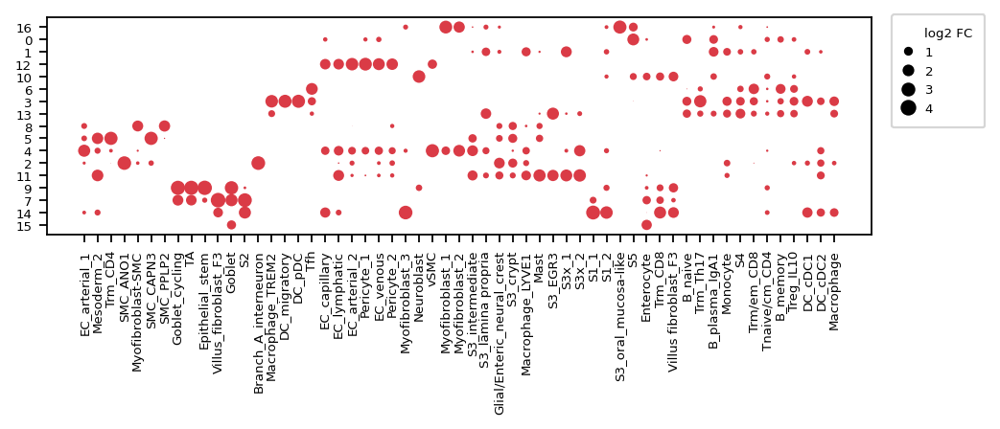

In [91]:
cc.pl.enrichment(
    adata,
    group_key='spatial_cluster17', label_key='annot',
    figsize=(6,3), fontsize=6, dot_scale=1,
    label_cluster=True,
    save="figures_niches/CellCharter_niches17_enrichment_dotplot.pdf")

## 18 clusters

In [61]:
gmm = cc.tl.Cluster(
    n_clusters=18, 
    random_state=42,
    # If running on GPU
    #trainer_params=dict(accelerator='gpu', devices=1)
)

In [62]:
gmm.fit(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=35` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=300` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=1` reached.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training: |          | 0/? [00:00<?, ?it/s]

In [63]:
adata.obs['spatial_cluster18'] = gmm.predict(adata, use_rep='X_cellcharter')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Predicting: |          | 0/? [00:00<?, ?it/s]

In [64]:
rcParams["figure.figsize"] = (6, 6)
sc.set_figure_params(dpi_save=450)

sq.pl.spatial_scatter(
    adata, 
    color='spatial_cluster18', 
    library_key='sample', 
    img=None, 
    title=adata.obs.sample.cat.categories,
    size=8,  # point size
    ncols=4,
    wspace=0.5,  # inter-panel width
    library_id=adata.obs.sample.cat.categories,
    save="figures_niches/CellCharter_niches18.pdf", dpi=450
)

In [65]:
cc.gr.enrichment(adata, group_key='spatial_cluster18', label_key='annot')

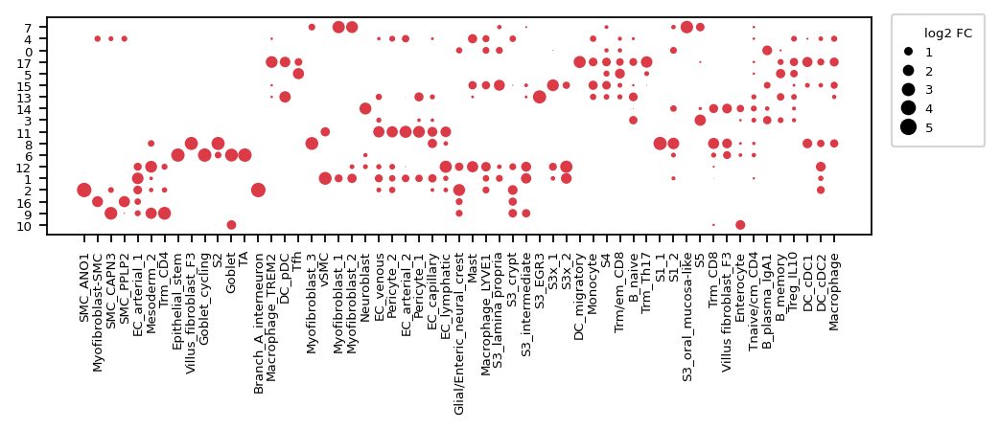

In [92]:
cc.pl.enrichment(
    adata,
    group_key='spatial_cluster18', label_key='annot',
    figsize=(6,3), fontsize=6, dot_scale=1,
    label_cluster=True,
    save="figures_niches/CellCharter_niches18_enrichment_dotplot.pdf")

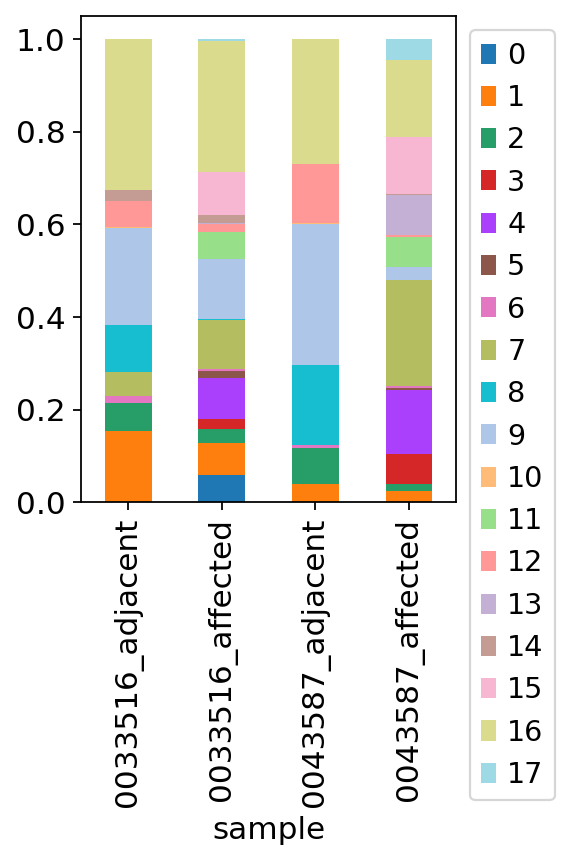

In [94]:
# WARNING: this plot has an error due to adata != adata_mesen

# Get dictionary of colors
color_dict = dict(zip(adata.obs.spatial_cluster18.cat.categories, adata.uns['spatial_cluster18_colors']))

rcParams["figure.figsize"] = (3, 4)

counts = pd.crosstab(adata.obs.spatial_cluster18, adata_mesen.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True, color=counts.index.map(color_dict))
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures_niches/barplot_xenium5k_CellCharter_niches18.pdf", bbox_inches ="tight")
#plt.show()

In [93]:
adata.write_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter.h5ad")